In [1]:
%load_ext autoreload
%autoreload 2

In [12]:
#!git clone https://github.com/europeana/rd-img-classification-pilot.git

import sys
sys.path.append('../')

import requests
import json
from PIL import Image
from io import BytesIO
import matplotlib.pyplot as plt

import torch
from src.inference import EuropeanaAPI, load_pytorch_model, make_prediction, plot_prediction, img_from_CHO


In [14]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model, class_index_dict = load_pytorch_model(device)

In [15]:
class_index_dict

{'0': 'archaeological_site',
 '1': 'building',
 '2': 'ceramics',
 '3': 'clothing',
 '4': 'costume_accessories',
 '5': 'drawing',
 '6': 'furniture',
 '7': 'inscription',
 '8': 'jewellery',
 '9': 'map',
 '10': 'painting',
 '11': 'photograph',
 '12': 'postcard',
 '13': 'sculpture',
 '14': 'specimen',
 '15': 'tapestry',
 '16': 'textile',
 '17': 'toy',
 '18': 'weaponry',
 '19': 'woodwork'}

In [16]:
eu = EuropeanaAPI('api2demo')

URI:  http://data.europeana.eu/item/2058612/object_CHB_01a0208072596d32d6642c10042bea18d81436fe
prediction: painting, confidence: 0.864


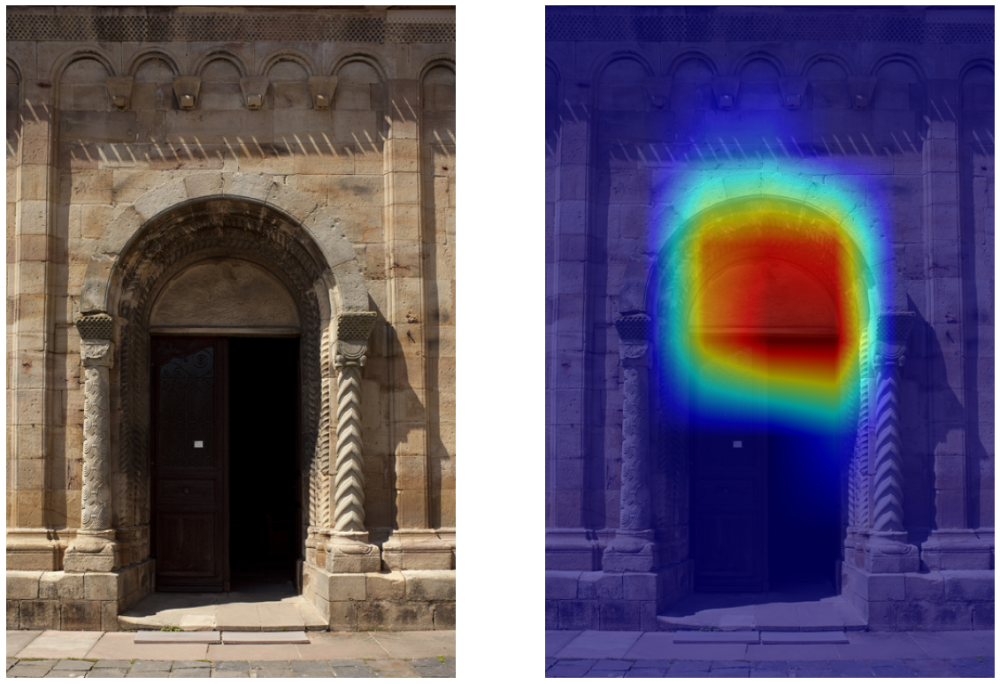






URI:  http://data.europeana.eu/item/2058612/object_CHB_01a0208072596d32d6642c10042bea18d81436fe
prediction: woodwork, confidence: 0.947


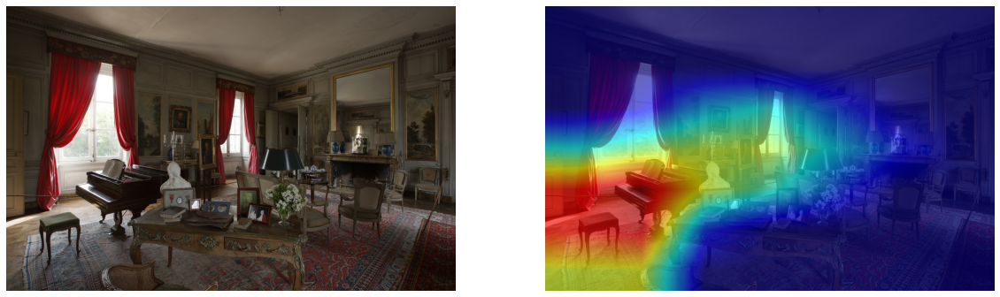






URI:  http://data.europeana.eu/item/2058612/object_CHB_01a0208072596d32d6642c10042bea18d81436fe
prediction: furniture, confidence: 0.570


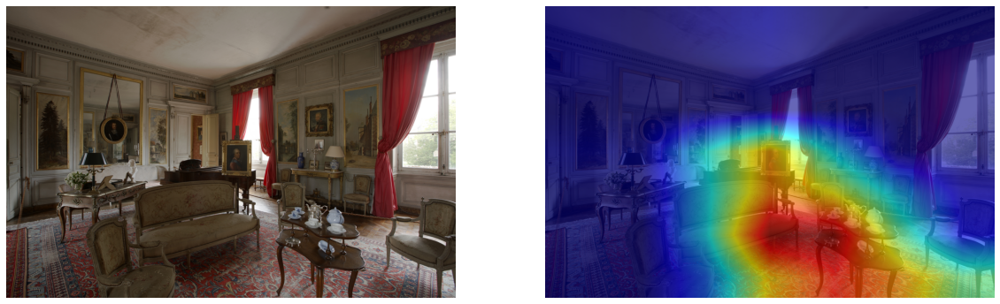






URI:  http://data.europeana.eu/item/2058612/object_CHB_01a0208072596d32d6642c10042bea18d81436fe
prediction: tapestry, confidence: 0.798


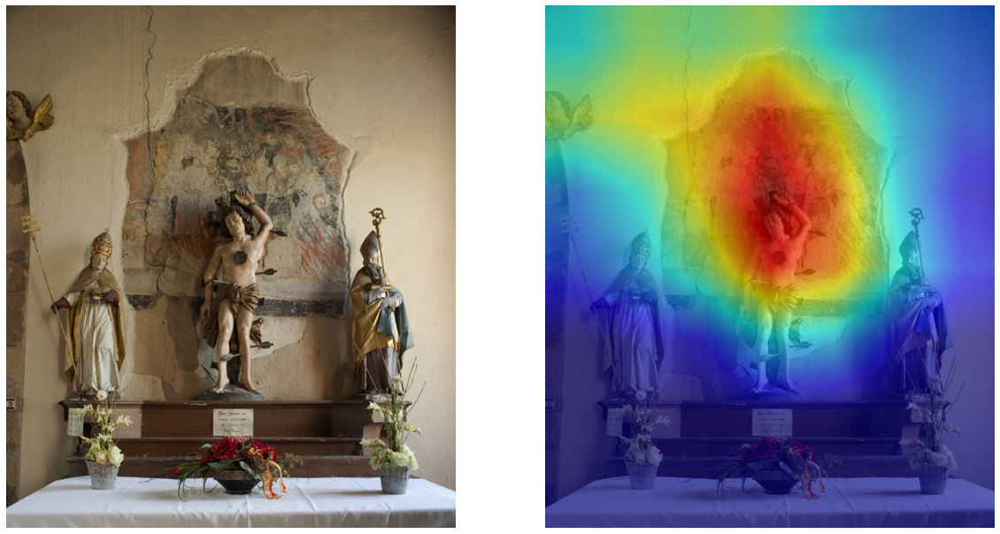






URI:  http://data.europeana.eu/item/2058612/object_CHB_01a0208072596d32d6642c10042bea18d81436fe
prediction: painting, confidence: 0.757


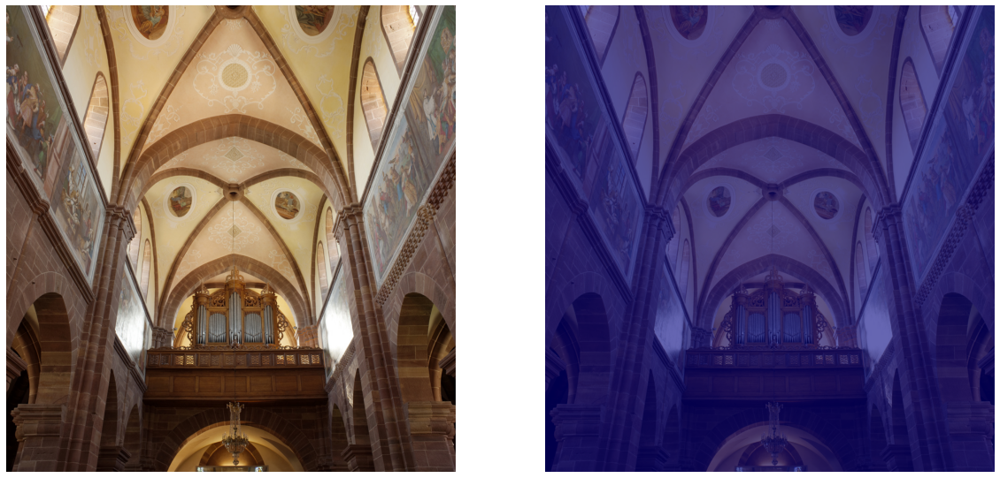






URI:  http://data.europeana.eu/item/2058612/object_CHB_01a0208072596d32d6642c10042bea18d81436fe
prediction: sculpture, confidence: 0.998


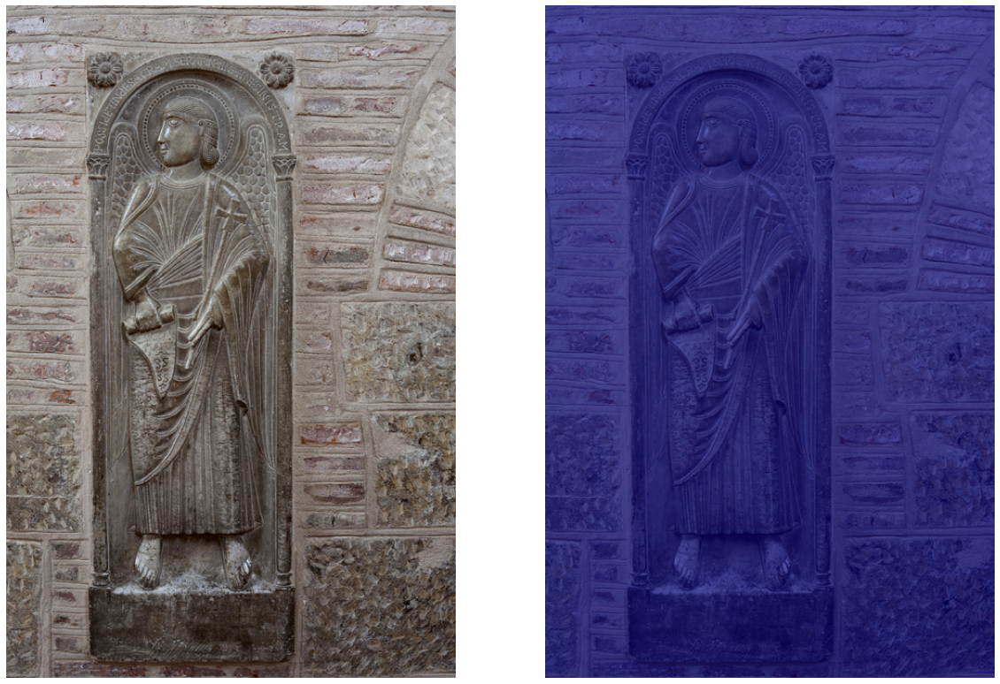






URI:  http://data.europeana.eu/item/2058612/object_CHB_01a0208072596d32d6642c10042bea18d81436fe
prediction: sculpture, confidence: 1.000


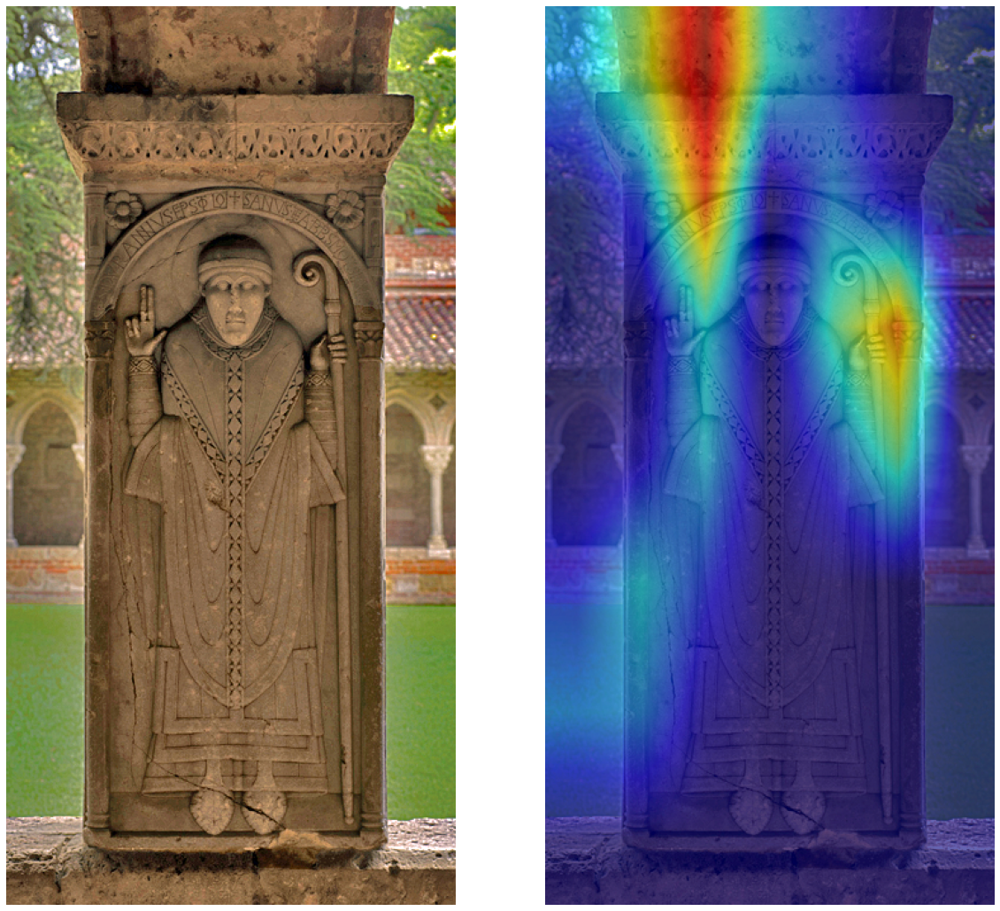






URI:  http://data.europeana.eu/item/2058612/object_CHB_01a0208072596d32d6642c10042bea18d81436fe
prediction: sculpture, confidence: 0.975


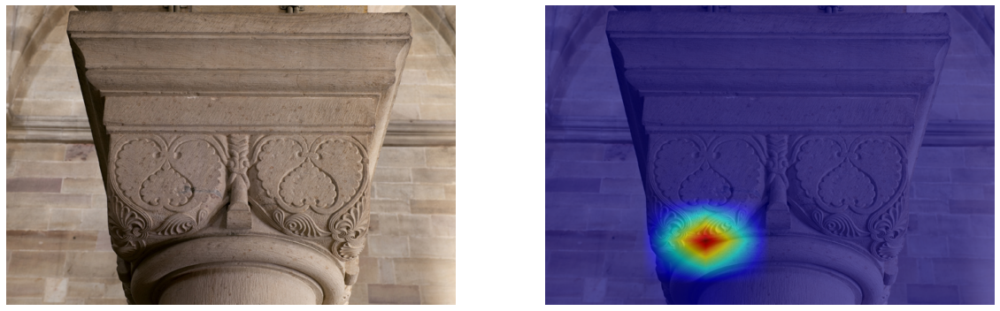






URI:  http://data.europeana.eu/item/2058612/object_CHB_01a0208072596d32d6642c10042bea18d81436fe
prediction: painting, confidence: 0.629


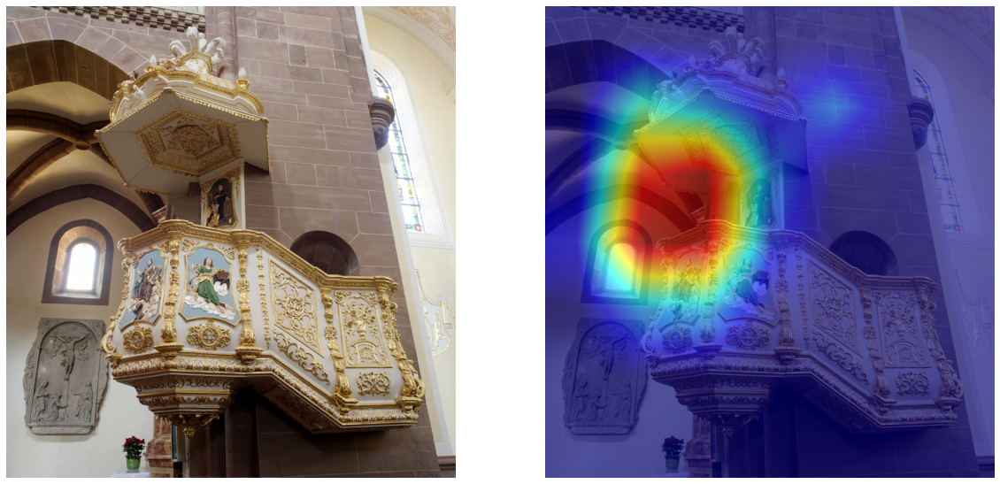






URI:  http://data.europeana.eu/item/2058612/object_CHB_01a0208072596d32d6642c10042bea18d81436fe
prediction: sculpture, confidence: 0.985


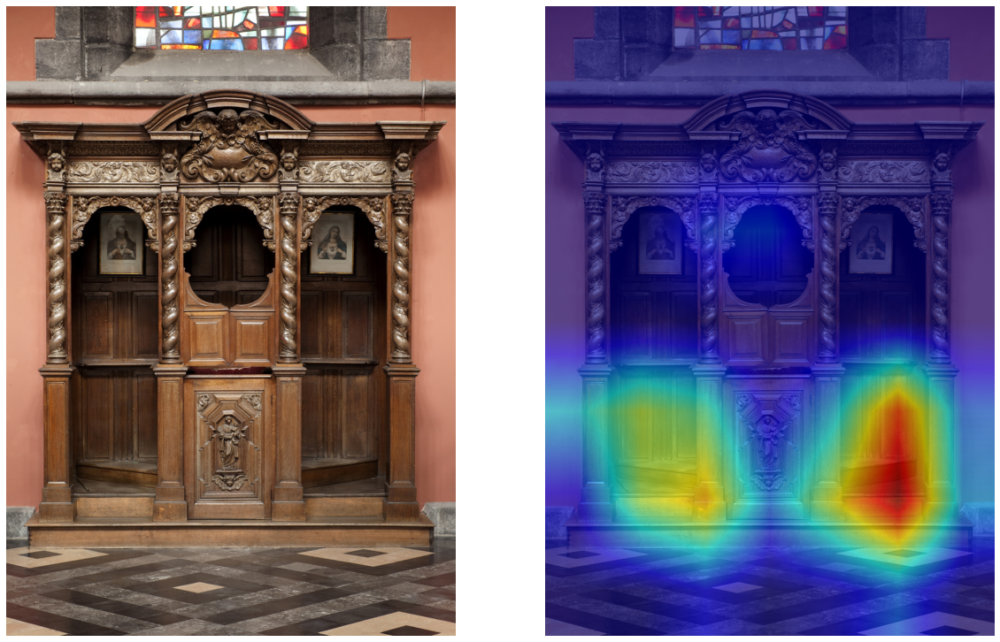






URI:  http://data.europeana.eu/item/2058612/object_CHB_01a0208072596d32d6642c10042bea18d81436fe
prediction: woodwork, confidence: 0.339


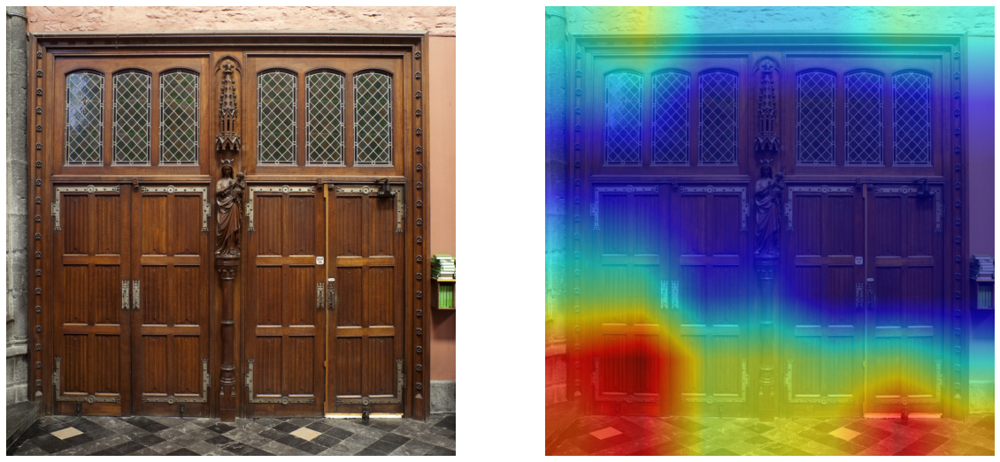






URI:  http://data.europeana.eu/item/2058612/object_CHB_01a0208072596d32d6642c10042bea18d81436fe
prediction: sculpture, confidence: 0.999


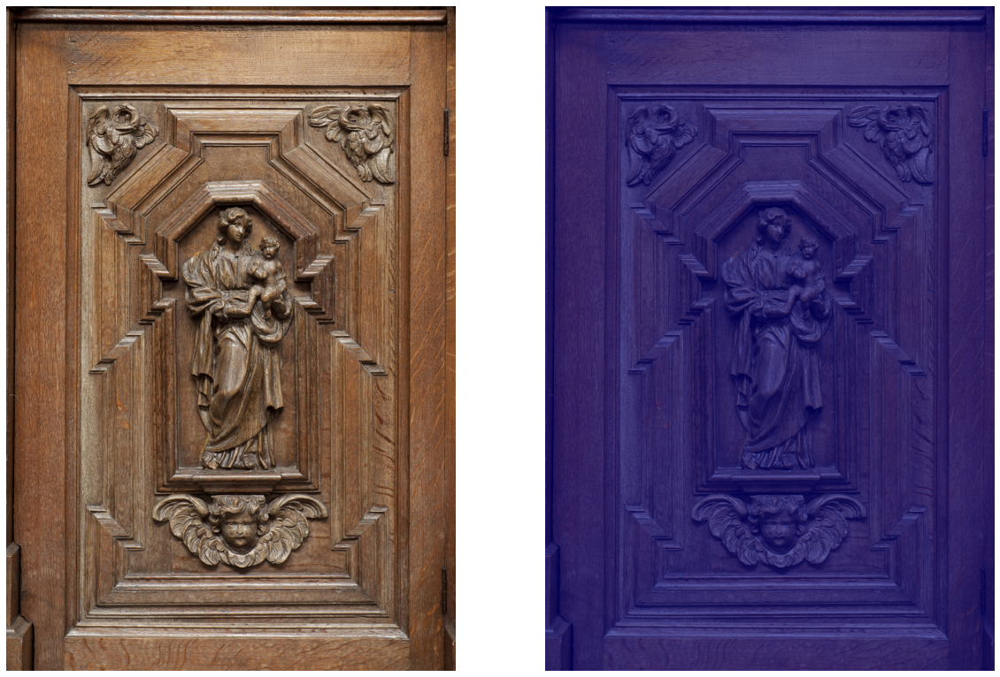






URI:  http://data.europeana.eu/item/2058612/object_CHB_01a0208072596d32d6642c10042bea18d81436fe
prediction: sculpture, confidence: 0.947


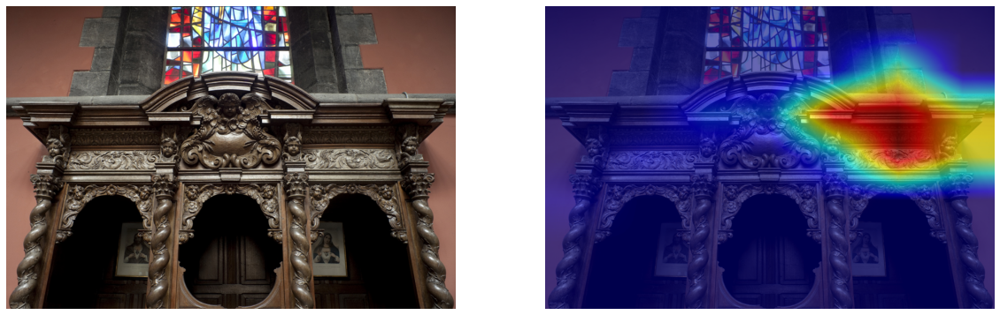






URI:  http://data.europeana.eu/item/2058612/object_CHB_01a0208072596d32d6642c10042bea18d81436fe
prediction: sculpture, confidence: 1.000


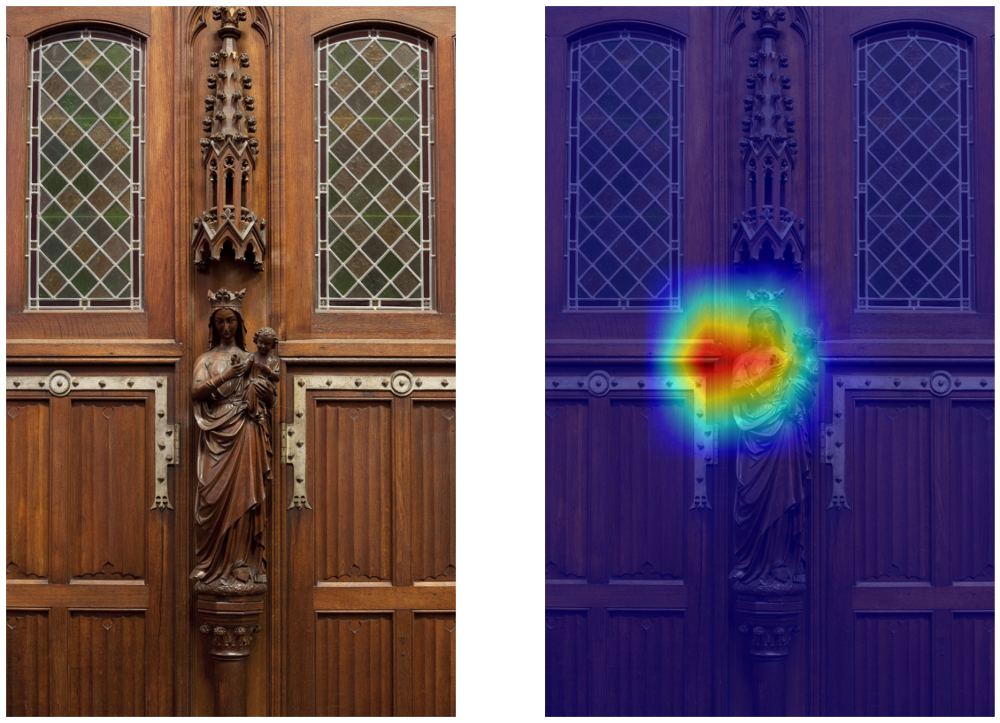






URI:  http://data.europeana.eu/item/2058612/object_CHB_01a0208072596d32d6642c10042bea18d81436fe
prediction: sculpture, confidence: 0.999


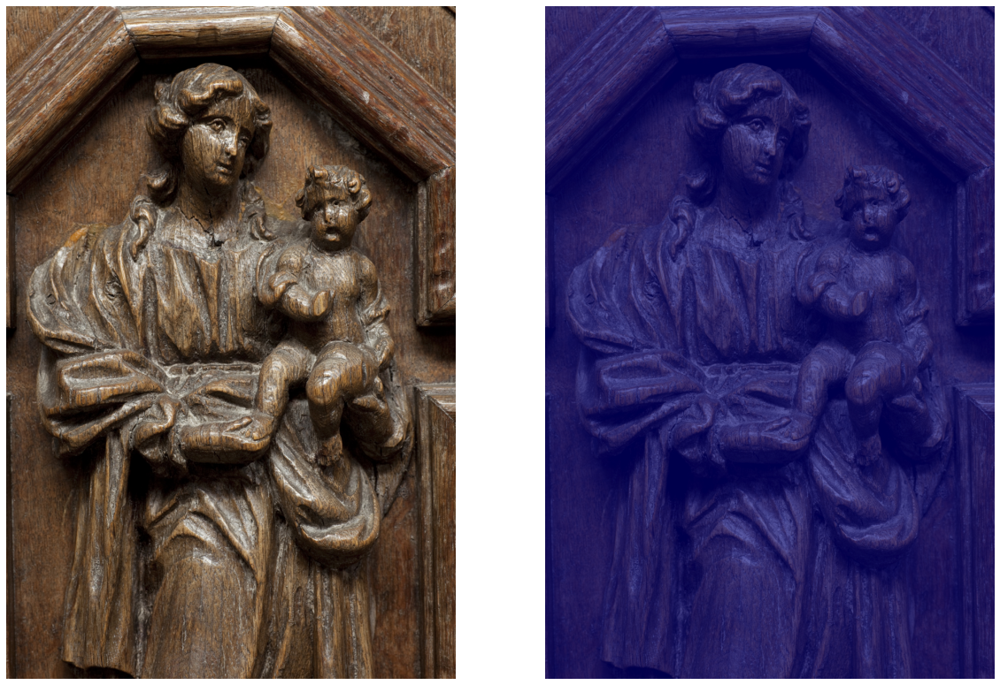






URI:  http://data.europeana.eu/item/2058612/object_CHB_01a0208072596d32d6642c10042bea18d81436fe
prediction: sculpture, confidence: 0.743


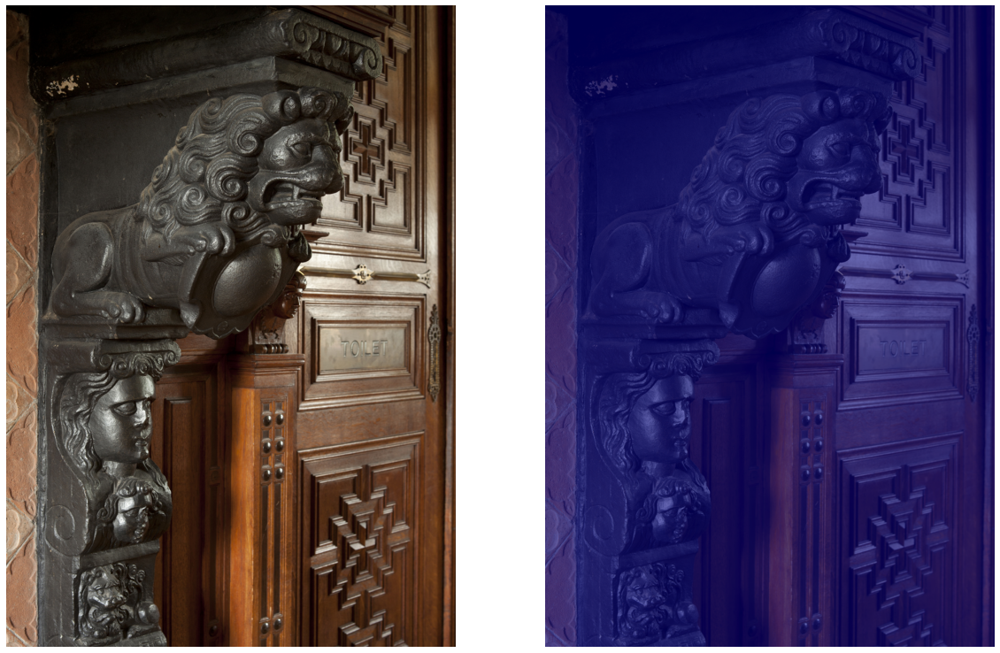






URI:  http://data.europeana.eu/item/2058612/object_CHB_01a0208072596d32d6642c10042bea18d81436fe
prediction: furniture, confidence: 0.882


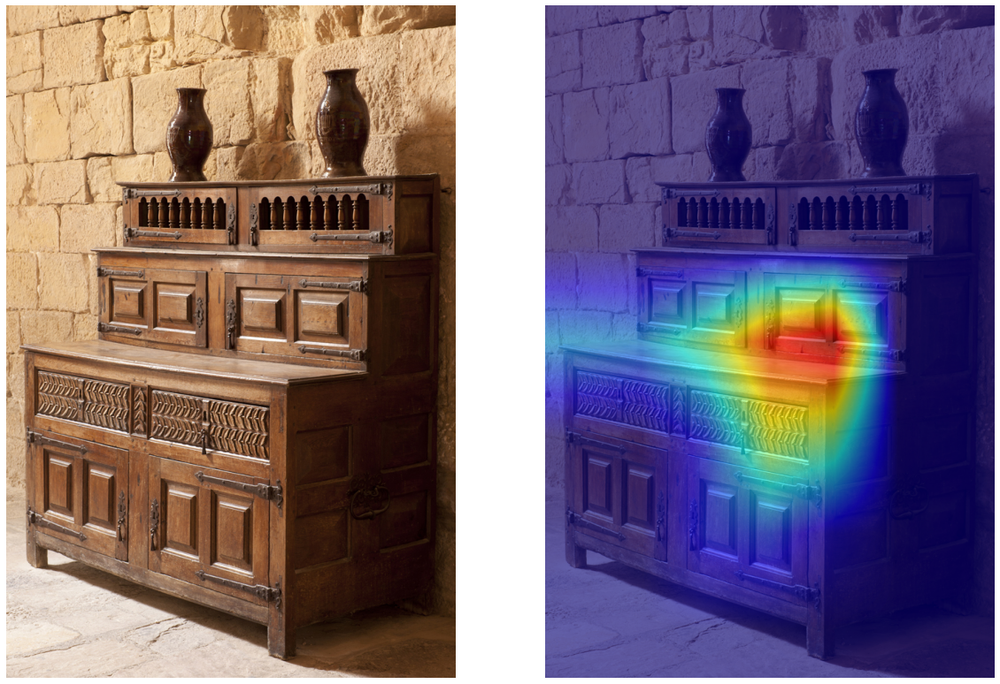






URI:  http://data.europeana.eu/item/2058612/object_CHB_01a0208072596d32d6642c10042bea18d81436fe
prediction: building, confidence: 0.999


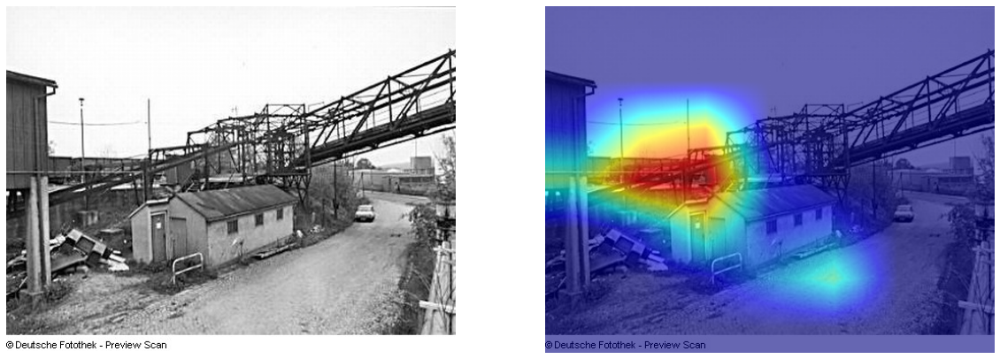






URI:  http://data.europeana.eu/item/2058612/object_CHB_01a0208072596d32d6642c10042bea18d81436fe
prediction: building, confidence: 1.000


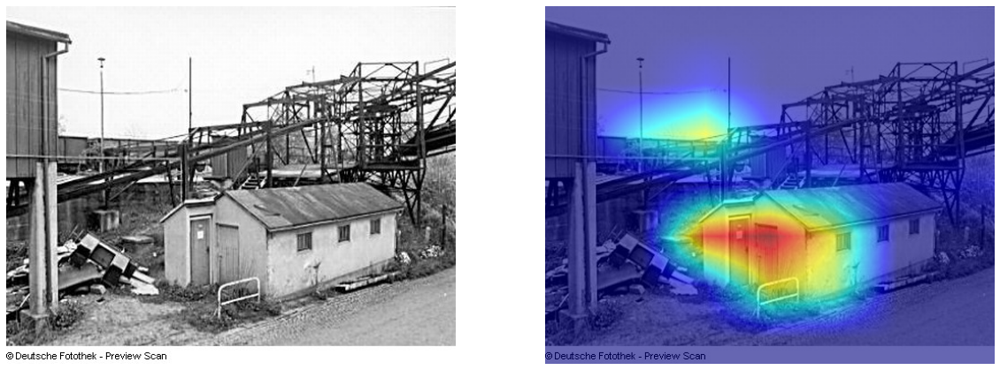






URI:  http://data.europeana.eu/item/2058612/object_CHB_01a0208072596d32d6642c10042bea18d81436fe
prediction: furniture, confidence: 0.996


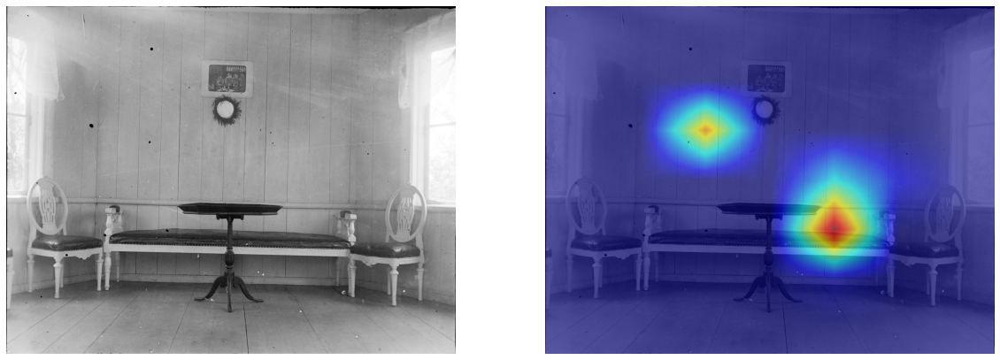

In [17]:

CHO_list = eu.search('building AND furniture')

for CHO in CHO_list:
    
  img = img_from_CHO(CHO)

  if not img:
        continue
    
  pred_idx, conf, XAI_img = make_prediction(model,img,device)

  pred =  class_index_dict[str(pred_idx)]

  print('URI: ','http://data.europeana.eu/item'+item['id'])
  print(f'prediction: {pred}, confidence: {conf:.3f}')
  
  plot_prediction(img,XAI_img)
  print(4*'\n')

    




